# Importing Libraries

In [ ]:
! pip install networkx
! pip install plotly
! pip install colorlover
! pip install NRCLex
! pip install tweet-preprocessor

import networkx as nx
import pandas as pd
from collections import Counter
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly.graph_objs import *
import plotly.graph_objects as go
init_notebook_mode(connected=True)
import random
import colorlover as cl
from IPython.display import HTML
from nrclex import NRCLex
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer 
import re
nltk.download('wordnet')
nltk.download('punkt')
nltk.download("stopwords")

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import preprocessor as p
from IPython.display import Image


     |████████████████████████████████| 399kB 13.5MB/s 
  Created wheel for NRCLex: filename=NRCLex-3.0.0-cp36-none-any.whl size=43313 sha256=bc66e4691113dff2ca31be9701ee0d27e201a7cdf7f3da3a94379346fb6cc521
  Stored in directory: /root/.cache/pip/wheels/17/31/64/035a8d245b4c217aeb8e8a2702d05dc91544b9c2334db72414
Successfully built NRCLex


[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


# Loading Data

In [ ]:
df = pd.read_csv("tweets2009-06-0115.csv.zip", sep='\t', compression='zip')

df['date'] = pd.to_datetime(df['date'], infer_datetime_format=False) # coverting date to datetime format

In [ ]:
print("Num of rows in df:", df.shape[0])

Num of rows in df: 3437690


In [ ]:
df.head()

,date,user,tweet
0,2009-06-01 21:43:59,burtonator,No Post Title
1,2009-06-01 21:47:23,burtonator,No Post Title
2,2009-06-02 01:15:44,burtonator,No Post Title
3,2009-06-02 05:17:52,burtonator,No Post Title
4,2009-06-02 23:58:25,burtonator,No Post Title


# Finding most common hashtags

In [ ]:
allTweets = df["tweet"].str.cat(sep=' ')
tweetWords = [word.strip(""" ,.:'\";""").lower() for word in allTweets.split()]
hashTags = [word for word in tweetWords if word.startswith("#")]
hashTagsCounter = Counter(hashTags)

In [ ]:
print('\n ############### Most frequent hashtags are = ############### \n')

hashTagsCounter.most_common(150)


 ############### Most frequent hashtags are = ############### 



[('#iranelection', 26853),
 ('#followfriday', 16400),
 ('#jobs', 13322),
 ('#iremember', 11057),
 ('#spymaster', 10587),
 ('#ff', 10446),
 ('#squarespace', 9198),
 ('#tcot', 7691),
 ('#fb', 6107),
 ('#cnnfail', 4451),
 ('#11thcommandment', 3429),
 ('#jtv', 3317),
 ('#140mafia', 3144),
 ('#iran', 2935),
 ('#', 2895),
 ('#news', 2837),
 ('#quote', 2750),
 ('#vampirebite', 2634),
 ('#1', 2587),
 ('#bsb', 2433),
 ('#tweetmyjobs', 2086),
 ('#iphone', 1697),
 ('#lastfm', 1599),
 ('#mp2', 1589),
 ('#niley', 1528),
 ('#music', 1489),
 ('#p2', 1439),
 ('#follow', 1390),
 ('#pawpawty', 1305),
 ('#hhrs', 1256),
 ('#fail', 1246),
 ('#twitter', 1216),
 ('#tlot', 1214),
 ('#facebook', 1177),
 ('#sgp', 1151),
 ('#mashchat', 1143),
 ('#tinychat', 1111),
 ('#2', 1107),
 ('#digg', 1102),
 ('#gop', 1009),
 ('#phish', 1001),
 ('#mlb', 962),
 ('#travel', 932),
 ('#bonnaroo', 887),
 ('#twitpocalypse', 879),
 ('#iranelections', 857),
 ('#rt', 856),
 ('#zensursula', 811),
 ('#jamlegend', 790),
 ('#quotes', 75

# **1. Choose a hash-tag**

### ('#cnnfail', 4451)

In [ ]:
############### make a new dataframe just with our hashtag
cnnfailTag = df[df["tweet"].str.lower().str.contains("#cnnfail", na=False)].copy()

# **2. Build a Mention Graph**

### **2(a) How many nodes and how many edges are in your mention graph?**

In [ ]:
############### Function to add mentioned column

def addMentionedColumn(df):
    
    def mentionsList(txt):
        allWords = [word.strip(""" ,.:'\";""").lower() for word in txt.split()]
        allNames = [word.strip("@") for word in allWords if word.startswith("@")]
        uniqueNames = list(set(allNames))
        return allNames
    
    df["mentioned"] = df["tweet"].apply(mentionsList)

In [ ]:
############### Getting the mentioned tag

addMentionedColumn(cnnfailTag)

In [ ]:
cnnfailTag.head(10)

,date,user,tweet,mentioned
2575522,2009-06-14 02:14:43,sxyblkmn,RT @MattReeves17: Help put pressure on CNN to ...,[mattreeves17]
2575948,2009-06-14 02:15:29,saharou,RT @MattReeves17: Help put pressure on CNN to ...,[mattreeves17]
2576897,2009-06-14 02:16:17,k_may_li,RT: @sxyblkmn: RT @MattReeves17: Help put pres...,"[sxyblkmn, mattreeves17]"
2576927,2009-06-14 02:16:18,spaley,@spaley RT Help put pressure on CNN to cover t...,"[spaley, mattreeves17)]"
2577020,2009-06-14 02:16:28,pogoose,RT @saharou: RT @MattReeves17: Help put pressu...,"[saharou, mattreeves17]"
2577689,2009-06-14 02:17:31,andrewfynn,saharou RT @MattReeves17: Help put pressure on...,[mattreeves17]
2577778,2009-06-14 02:17:39,raconteurreal,RT Chatter about Gitmo on CNN instead of cover...,[]
2578537,2009-06-14 02:18:31,sambhav6,@Saharou RT @MattReeves17: Help put pressure o...,"[saharou, mattreeves17]"
2578608,2009-06-14 02:18:40,larkin,RT @kiyanforoughi: Help put pressure on CNN to...,[kiyanforoughi]
2580681,2009-06-14 02:20:57,slbbw,RT @sambhav6 @Saharou RT @MattReeves17: Help p...,"[sambhav6, saharou, mattreeves17]"


In [ ]:
############### Funciton to build a mention graph

def mentionGraph(df):
    g = nx.Graph()
    
    for (index, date, user, tweet, mentionedUsers) in df.itertuples():
        for mentionedUser in mentionedUsers:
            if (user in g) and (mentionedUser in g[user]):
                g[user][mentionedUser]["numberMentions"] += 1
            else:
                g.add_edge(user, mentionedUser, numberMentions=1)
    
    return g

In [ ]:
cnnfailGraph = mentionGraph(cnnfailTag)

print('\n ############### Number of nodes and edges are = ############### \n')

print("# nodes:", len(cnnfailGraph.nodes()))
print("# edges:", len(cnnfailGraph.edges()))


 ############### Number of nodes and edges are = ############### 

# nodes: 2740
# edges: 4439


### **Answer 2.a**

 nodes: 2740
 
 edges: 4439


### **2 (b) Build a histogram of the graph nodes' degree (i.e., the degree distribution of the graph). What does the distribution in node degree tell you about how your network is structured?**

In [ ]:
############### Getting pandas df from the degree dictionary of the graph

degree_dict = dict(nx.degree(cnnfailGraph))
degree_dict_df = pd.DataFrame.from_dict(degree_dict, orient='index', columns = ['degree']).sort_values(by = 'degree', ascending = False)

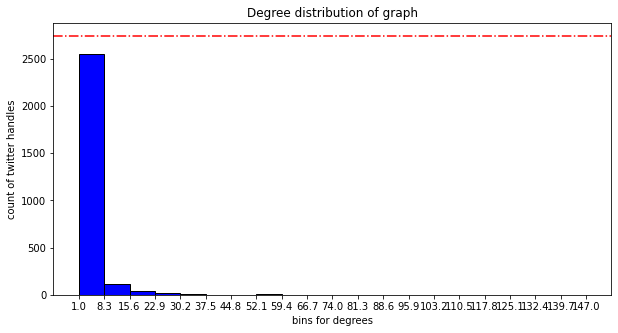

In [ ]:
############### Building a histogram of degree distribution

fig, ax = plt.subplots(figsize=(10,5))

counts, bins, patches = ax.hist(degree_dict_df['degree'], facecolor='blue', edgecolor='black', bins = 20)
ax.set_xticks(bins)
ax.set_xlabel('bins for degrees')
ax.set_ylabel('count of twitter handles')
ax.set_title('Degree distribution of graph')
plt.axhline(y=len(cnnfailGraph.nodes()), color='r', linestyle='-.')

plt.show()

**Note** = The dotted line in the plot above shows the total nodes in the graph

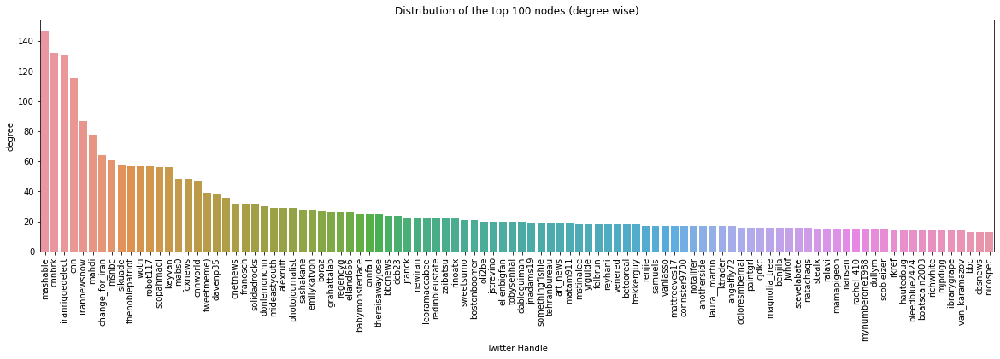

In [ ]:
############### Building histogram of the degree distribution

fig, ax = plt.subplots(figsize=(20,5))
plt.xticks(rotation = 90)
plt.xlabel('Twitter Handle')
plt.ylabel('degree')
plt.title('Distribution of the top 100 nodes (degree wise)')

ax = sns.barplot(x=degree_dict_df.index[0:100], y=degree_dict_df['degree'][0:100])

In [ ]:
print('\n ############### top 3 nodes with most degrees = ############### \n')

print(degree_dict_df.index[0:3])


 ############### top 3 nodes with most degrees = ############### 

Index(['mashable', 'cnnbrk', 'iranriggedelect'], dtype='object')


### **Answer 2.b**

1. from the degree distribution of graph plot, it is clear that more than 90% of the nodes have a degree between 1 to 8.
2. Top 3 nodes with most degrees are 'mashable', 'cnnbrk', 'iranriggedelect' meaning either many users are mentioning these handles or these handles are mentioning many people in their posts

###**2 (c) Build a log-log scatterplot with the node degree (x-axis) and fraction of nodes with that degree (y-axis). Does your mention graph exhibit a power law trend? If not, can you explain why that may be?**


When you have data whose range spans several orders of magnitude, you should consider whether a log transform will enhance the visualization. A log transformation preserves the order of the observations while making outliers less extreme. (It also spreads out values that are in [0,1], but that doesn't apply for these data.) 

reference - https://blogs.sas.com/content/iml/2014/07/09/scatter-plots-with-log-axes.html

In [ ]:
############### getting fraction of nodes with that degree

node_fract_dict = dict(Counter(degree_dict_df['degree'].values))
node_fract_df = pd.DataFrame.from_dict(node_fract_dict, orient='index', columns = ['number_of_nodes'])
node_fract_df['degree'] = node_fract_df.index
node_fract_df.reset_index(drop=True)

node_fract_df['fraction_of_nodes'] = node_fract_df['number_of_nodes']/node_fract_df['number_of_nodes'].sum()

assert(node_fract_df['fraction_of_nodes'].sum() == 1.0)

node_fract_df.head(3)

,number_of_nodes,degree,fraction_of_nodes
147,1,147,0.000365
132,1,132,0.000365
131,1,131,0.000365


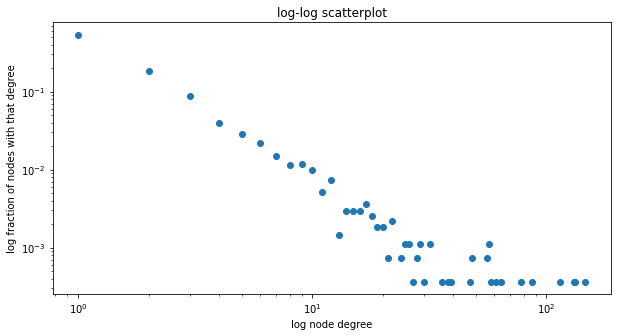

In [ ]:
############### Building log log scatter plot 

fig, ax = plt.subplots(figsize=(10,5))
# ax = plt.gca()
ax.scatter(node_fract_df['degree'] ,node_fract_df['fraction_of_nodes'])
ax.set_yscale('log')
ax.set_xscale('log')

ax.set_xlabel('log node degree')
ax.set_ylabel('log fraction of nodes with that degree')
ax.set_title('log-log scatterplot')

plt.show()

### **Answer 2.c**

Yes, the the linear relelationship of the log graph indicates that the two quantities have a power law trend. Meaning as the number of node degree increases, the fraction of nodes with that degree decreases by a power factor of the former.



reference - https://www.statisticshowto.com/power-law/

### **2 (d) For the highest-weighted edge, list the tweets (up to 25) for that edge and describe the interaction between these two users which explains why this edge has the highest weight. Note: edges are identied be the two nodes they connect, e.g., hnode1; node2i.**

In [ ]:
############### Getting the nodes with the highest mentions (edge weight)

max_edge_weight_tuple = max(dict(cnnfailGraph.edges).items(), key=lambda x: x[1]['numberMentions'])

print('\n ############### tuple with max edge weight is = ############### \n')

max_edge_weight_tuple

#reference - https://stackoverflow.com/questions/52440518/finding-maximum-weighted-edge-in-a-networkx-graph-in-python


 ############### tuple with max edge weight is = ############### 



(('notalifer', 'keyvan'), {'numberMentions': 11})

In [ ]:
############### Filtering tweets between these 2 nodes by filtering based on "user" and "mentioned"

df_q2d = cnnfailTag[(cnnfailTag['user'].isin([max_edge_weight_tuple[0][0]])) | (cnnfailTag['user'].isin([max_edge_weight_tuple[0][1]]))]
df_q2d['mentioned_set'] = df_q2d['mentioned'].apply(lambda x: set(x))
df_q2d = df_q2d[df_q2d['mentioned_set'] - set([max_edge_weight_tuple[0][0], max_edge_weight_tuple[0][1]]) != df_q2d['mentioned_set']]
df_q2d = df_q2d.sort_values(by = 'date')

assert(df_q2d.shape[0] == max_edge_weight_tuple[1]['numberMentions'])

df_q2d.head(3)

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,date,user,tweet,mentioned,mentioned_set
2650246,2009-06-14 03:46:24,notalifer,RT @keyvan: Cell phones back! At least in our ...,[keyvan],{keyvan}
2672519,2009-06-14 04:16:12,notalifer,RT @keyvan: Myfriend n Polytechnic university:...,[keyvan],{keyvan}
2680419,2009-06-14 04:26:29,notalifer,RT @bfxgirl: RT @keyvan I hope wstrn ppl can s...,"[bfxgirl, keyvan]","{keyvan, bfxgirl}"


In [ ]:
############### Printing tweets between these 2 nodes

pd.set_option('display.max_columns', None)  
pd.set_option('display.expand_frame_repr', False)
pd.set_option('max_colwidth', 500)

df_q2d[['date', 'user', 'tweet', 'mentioned']]

,date,user,tweet,mentioned
2650246,2009-06-14 03:46:24,notalifer,RT @keyvan: Cell phones back! At least in our area. #IranElection #CNNFail http://myloc.me/3KPG,[keyvan]
2672519,2009-06-14 04:16:12,notalifer,RT @keyvan: Myfriend n Polytechnic university: itwasa scarynight.Thy atackd us & any1 n the streets. Many injures. #IranElection #CNNFail,[keyvan]
2680419,2009-06-14 04:26:29,notalifer,RT @bfxgirl: RT @keyvan I hope wstrn ppl can see why western media like #CNNFail hve ben tryna draw a different face of Iranians for you.,"[bfxgirl, keyvan]"
2700984,2009-06-14 04:58:18,notalifer,"RT @keyvan: It seems tht all reformists r under home arrst.Nonews coming out from Mousavi, Khatami, Karoubi, n othes. #IranElection #CNNFail",[keyvan]
2709708,2009-06-14 05:11:24,notalifer,RT @keyvan: Amir Abad street in Tehran University neighborhood in blocked. #IranElection #CNNFail http://myloc.me/3Ln2,[keyvan]
2711032,2009-06-14 05:13:23,notalifer,RT @keyvan: Iranian regime will sue Twitter for this coverage :-D! #IranElection #CNNFail http://myloc.me/3LnE,[keyvan]
2725028,2009-06-14 05:30:33,notalifer,"RT @keyvan: We, most of Iranian tweeters, are trying to be independent and report events. I hope #CNNFail was doing this! #IranElection",[keyvan]
2738765,2009-06-14 05:51:13,notalifer,RT @keyvan: I'm so sorry I can't reply ur tweets. Connection is slow and there are many replies that I can't follow. #IranElection #CNNFail,[keyvan]
2739478,2009-06-14 05:52:25,notalifer,RT @keyvan: Rumors around about #Mousavi request from his supporters to rally in Tehran. #IranElection #CNNFail http://myloc.me/3LAa,[keyvan]
2787590,2009-06-14 07:13:10,notalifer,RT @keyvan: Thank you for all your help and support :-) #IranElection #CNNFail http://myloc.me/3LYA,[keyvan]


### **Answer 2.d**

1. It seems that all the tweets between 'notalifer' and 'keyvan' were made on the same day between 3am to 8am

2. 'notalifer' seems to be reporting the events taking place during the iran elections to the 'kevyan'.

3. 'notalifer' is unhappy the way western media (CNN, #CNNfail) covered the iran elections and blames CNN of drawing a different face of iranians to the world.

4. 'notalifer' also mentions that the reformists are under home arrest and western media is not covering any such thing during the iran elections

5. He is giving live updates about the events around him, hence the high number of references

### **2 (e) Provide a visualization of the mention graph in which the edges visually (e.g., color, weight, etc.) reects its weight (i.e., the number of mentions). Note: Be sure to use layouts to help make the visualizations clear.**

In [ ]:
############### map purd color scale to 300 cells

purd = cl.scales['9']['seq']['PuRd']
purd300 = cl.interp(purd, 300)
# HTML(cl.to_html(purd300))

In [ ]:
############### Generate random positions for nodes and store them at property "pos"

import random
def addRandomPositions(graph):
    posDict = dict((node,(random.gauss(0,10),random.gauss(0,10))) for node in graph.nodes())
    nx.set_node_attributes(graph, name="pos", values=posDict)

############### Visualize using Plot.ly scatter plots

def plotNetworkSizeColor(graph):
    closenessCentr = nx.closeness_centrality(graph)
    maxCentr = max(closenessCentr.values())
    minCentr = min(closenessCentr.values())
    
    scatters=[]

    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines', 
                line=scatter.Line(width=edgeWidth ,color='#888'))
        scatters.append(s)



    for node in graph.nodes():
        nodeCentr = closenessCentr[node]
        nodeColor = int(299*(nodeCentr-minCentr)/(maxCentr-minCentr))
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text="User: %s <br> Closeness: %.3f" % (node, nodeCentr),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color=purd300[nodeColor], 
                    size=nx.degree(graph,node)*2,         
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False)
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)

def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))
  
def applyLayout(graph, layoutFunc):
    posDict = layoutFunc(graph) 
    nx.set_node_attributes(graph, name="pos", values=posDict)

In [ ]:
cnnfailGraph_spring = cnnfailGraph.copy()
applyLayout(cnnfailGraph_spring, nx.spring_layout)
configure_plotly_browser_state()
plotNetworkSizeColor(cnnfailGraph_spring)

In [ ]:
print('\n ############### (Static image) - Using spring layout which will be removed while uploading notebook to save space ###############')

# Image('newplot_q2e.png')


 ############### (Static image) - Using spring layout which will be removed while uploading notebook to save space ###############


# **3. Content Analysis**

### **3 (a) Analyze the most frequent non-stopwords in all the tweets with the chosen hash-tag, and provide a basic description of the main themes.**

In [ ]:
############### Cleaning the tweets

"""
Removing =

URLs
Hashtags
Mentions
Reserved words (RT, FAV)
Emojis
Smileys

"""
def replace_words(s, words_dict):
    for k, v in words_dict.items():
        s = s.replace(k, v)
    return s

to_replace_dict = {'shpuld':'should', 'nfor':'for', '\u2019':'', ' buget ':' budget ', ' famili ':' family ', 'RT':'', ':':'', 'pls':'please'}

cnnfailTag_q3a = cnnfailTag.copy()
cnnfailTag_q3a['cleaned_tweet'] = cnnfailTag_q3a['tweet'].apply(lambda x: p.clean(x)) # tweet preprocessor function imported as p
cnnfailTag_q3a['cleaned_tweet'] = cnnfailTag_q3a['cleaned_tweet'].apply(lambda x: replace_words(x, to_replace_dict)) # tweet preprocessor function imported as p

cnnfailTag_q3a.head(2)

,date,user,tweet,mentioned,cleaned_tweet
2575522,2009-06-14 02:14:43,sxyblkmn,RT @MattReeves17: Help put pressure on CNN to cover the IRAN protests more by putting #CNNfail in your tweets! #IranElection,[mattreeves17],Help put pressure on CNN to cover the IRAN protests more by putting in your tweets!
2575948,2009-06-14 02:15:29,saharou,RT @MattReeves17: Help put pressure on CNN to cover the IRAN protests more by putting #CNNfail in your tweets! #IranElection,[mattreeves17],Help put pressure on CNN to cover the IRAN protests more by putting in your tweets!


In [ ]:
############### Function to get most frequent non stop words

def get_stop_words():
    stop = set(stopwords.words('english'))
    #Add possible Stop Words for tweets
    stop.update(['said', 'highly', 'get', 'okay', 'let', 'also', 'one', 'back', 'the','nthe', 'could', 'we', 'nwe', 'got', 'upon', 'another','u2019t', 'u00e8r', "n't", "didn't", 
                 "didn\u2019t", "its", "it's", "it\u2019s", "dont", "don't", "don\u2019t", "u're", "u00e8re", 'nthere', 'there', 'nfor', 'for', 'yet', 'room', 'cnnfail', 'http', 
                 'com', 'tinyurl', 'via', 'still', 'like'])
    return stop

def lemmatize_tokens(list_tokens):
  lemmatizer = WordNetLemmatizer()
  output_tokens = []
  for word in list_tokens:
    output_tokens.append(lemmatizer.lemmatize(word))
  
  return output_tokens

def getTopKWords(df, kwords, col = 'cleaned_tweet'):

    stop = get_stop_words()
    counter = Counter()

    tweets = df[col].values

    for tweet in tweets:
            counter.update([word.lower() 
                            for word 
                            in lemmatize_tokens(re.findall(r'\w+', tweet))    # nltk.word_tokenize(tweet) # re.findall(r'\w+', tweet)
                            if word.lower() not in stop and len(word) > 2])
    topk = counter.most_common(kwords)
    return topk

In [ ]:
############### Getting most frequent non stop words

most_freq_words = getTopKWords(cnnfailTag_q3a, kwords = 50, col = 'cleaned_tweet')
print('\n ############### Most frequent words are = ############### \n')
most_freq_words


 ############### Most frequent words are = ############### 



[('iran', 1453),
 ('cnn', 1273),
 ('twitter', 845),
 ('news', 536),
 ('election', 422),
 ('please', 404),
 ('coverage', 289),
 ('tehran', 268),
 ('blasts', 251),
 ('network', 247),
 ('bbc', 242),
 ('medium', 225),
 ('protest', 218),
 ('covering', 217),
 ('people', 217),
 ('cover', 216),
 ('twitterverse', 196),
 ('iranian', 193),
 ('slam', 185),
 ('absence', 183),
 ('video', 177),
 ('2009', 142),
 ('story', 136),
 ('mousavi', 136),
 ('shame', 134),
 ('trending', 132),
 ('tweet', 127),
 ('arrested', 121),
 ('elections', 114),
 ('revolution', 112),
 ('need', 111),
 ('check', 110),
 ('riot', 108),
 ('users', 108),
 ('topic', 107),
 ('iranians', 100),
 ('new', 100),
 ('world', 99),
 ('word', 94),
 ('top', 89),
 ('spread', 88),
 ('hour', 86),
 ('report', 84),
 ('street', 84),
 ('dear', 84),
 ('good', 83),
 ('police', 80),
 ('see', 79),
 ('tonight', 78),
 ('today', 76)]

In [ ]:
np.where(cnnfailTag_q3a['cleaned_tweet'].str.contains('riot').values == True)[0][:10]

array([143, 345, 629, 682, 683, 717, 718, 733, 807, 826])

In [ ]:
cnnfailTag_q3a['cleaned_tweet'].iloc[629]

'Wow! has the rioting really escalated to the level of a quote and quote revolution? trs dsastreux!'

### **Answer 3.a**

**Main Theme** = Negative sentiment against western media and iran's authorities for poor and dishonest coverage of iran's elections.

The words such as 'iran', 'election', 'protest', 'blast', 'cnn', 'bbc', 'abscence', 'shame' indicate that most of the tweets related to #cnnfail are of iran election and the high escalation of the riots and protests during the 2009 iran elections.

Moreover the tweets unanimously mentioned that western media such as 'cnn' and 'bbc' are not honestly covering the election protests and are showing the wrong face of iranians to the world

### **3 (b) In a visualization of the mention graph add hover information for the nodes which lists the 3 most common words for each user. Indicate the nodes that have no words visually. For those nodes that have words, are the words similar for connected users or are the words dierent? If not the same, do the words have similar themes?**

In [ ]:
############### Function to get top 3 words for each node

def getTopKWords_user(df, user_node, tweetcol = 'cleaned_tweet', usercol = 'user', kwords = 3):
  df_ = df[df[usercol]==user_node]
  most_freq_words = getTopKWords(df_, kwords = kwords, col = tweetcol)
  most_freq_words = [tup[0] for tup in most_freq_words]
  return most_freq_words

In [ ]:
############### Visualize using Plot.ly scatter plots

def plotNetworkSizeColor_q3b(graph, cnnfailTag_q3a, kwords = 3):
    closenessCentr = nx.closeness_centrality(graph)
    maxCentr = max(closenessCentr.values())
    minCentr = min(closenessCentr.values())
    
    scatters=[]

    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines', 
                line=scatter.Line(width=edgeWidth ,color='#888'))
        scatters.append(s)



    for node in graph.nodes():
        nodeCentr = closenessCentr[node]
        nodeColor = int(299*(nodeCentr-minCentr)/(maxCentr-minCentr))
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text="User: %s <br> Closeness: %.3f <br> top 3 words: %s" % (node, nodeCentr, getTopKWords_user(cnnfailTag_q3a, user_node = node, kwords = kwords)),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color=purd300[nodeColor] if len(getTopKWords_user(cnnfailTag_q3a, user_node = node, kwords = kwords))>0 else cl.scales['9']['qual']['Set1'][5] , 
                    size=nx.degree(graph,node)*2,         
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False)
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)

In [ ]:
print('\n\n ############### (Static Image) Using spring layout with hover for top 3 views with nodes highlighted with no top words (yellow) ###############')
s
applyLayout(cnnfailGraph_spring, nx.spring_layout)
configure_plotly_browser_state()
plotNetworkSizeColor_q3b(cnnfailGraph_spring, cnnfailTag_q3a, kwords = 3)



 ############### (Static Image) Using spring layout with hover for top 3 views with nodes highlighted with no top words (yellow) ###############


**Note** The **yellow** coloured nodes are the ones with **no** top 3 words

In [ ]:
print('\n\n ############### (Static Image) Using spring layout with hover for top 3 views with nodes highlighted with no top words (yellow) which will be removed while uploading notebook to save space ###############')

# Image('newplot_q3b.png')



 ############### (Static Image) Using spring layout with hover for top 3 views with nodes highlighted with no top words (yellow) which will be removed while uploading notebook to save space ###############


### **Answer 3.b**

Interconnected nodes with top 3 words were analysed and there top 3 words matched with the theme of Iran Elections protest not being covered by western media groups like cnn and bbc. For the user 'vjack', 'jetty_os2' ... the common words are 'cnn', 'iran', 'blasts' etc which match the theme of Negative sentiment against western media and iran's authorities for poor and dishonest coverage of iran's elections.



# **4. Centrality Analysis**

### **4 (a) Using PageRank and a 2nd centrality measure of your choosing, calculate the centrality of the nodes on your graph based on each of the measures. Provide a mention graph visualization for each measure that demonstrates the centrality value of each node using a visual property (size, color, etc) for each of the centrality measures.**

In [ ]:
############### Visualize using Plot.ly scatter plots

def plotNetworkSizeColor_q4a(graph, cnnfailTag_q3a, kwords = 3, centralitynx = 'closeness'):

    if centralitynx == 'betweenness':
      closenessCentr = nx.betweenness_centrality(graph)
    elif centralitynx == 'pagerank':
      closenessCentr = nx.pagerank(graph)
    elif centralitynx == 'closeness':
      closenessCentr = nx.closeness_centrality(graph)


    maxCentr = max(closenessCentr.values())
    minCentr = min(closenessCentr.values())
    
    scatters=[]

    for (node1, node2) in graph.edges():
        x0, y0 = graph.nodes[node1]['pos']
        x1, y1 = graph.nodes[node2]['pos']
        edgeWidth = graph[node1][node2]['numberMentions']
        s = Scatter(
                x=[x0, x1],
                y=[y0, y1],
                hoverinfo='none',
                mode='lines', 
                line=scatter.Line(width=edgeWidth ,color='#888'))
        scatters.append(s)



    for node in graph.nodes():
        nodeCentr = closenessCentr[node]
        nodeColor = int(299*(nodeCentr-minCentr)/(maxCentr-minCentr))
        xPos, yPos = graph.nodes[node]['pos']
        s = Scatter(
                x=[xPos], 
                y=[yPos], 
                text="User: %s <br> Centrality_score: %.3f <br> top 3 words: %s" % (node, nodeCentr, getTopKWords_user(cnnfailTag_q3a, user_node = node, kwords = kwords)),
                hoverinfo='text',
                mode='markers', 
                marker=dict(
                    color=purd300[nodeColor], #if len(getTopKWords_user(cnnfailTag_q3a, user_node = node, kwords = kwords))>0 else cl.scales['9']['qual']['Set1'][5]
                    size=nx.degree(graph,node)*2,         
                    line=dict(width=2)))
        scatters.append(s)
    
    layout = Layout(showlegend=False)
    fig = Figure(data=scatters, layout=layout)
    iplot(fig, show_link=False)

In [ ]:
print('\n ############### Using spring layout with betweenness centrality ###############')

applyLayout(cnnfailGraph_spring, nx.spring_layout)
configure_plotly_browser_state()
plotNetworkSizeColor_q4a(cnnfailGraph_spring, cnnfailTag_q3a, kwords = 3, centralitynx = 'betweenness')


 ############### Using spring layout with betweenness centrality ###############


In [ ]:
print('\n ############### (Static Image) Using spring layout with betweenness centrality which will be removed while uploading notebook to save space ###############')

# Image('newplot_q4a_1.png')


 ############### (Static Image) Using spring layout with betweenness centrality which will be removed while uploading notebook to save space ###############


In [ ]:
print('\n ############### Using spring layout with page rank centrality ###############')

applyLayout(cnnfailGraph_spring, nx.spring_layout)
configure_plotly_browser_state()
plotNetworkSizeColor_q4a(cnnfailGraph_spring, cnnfailTag_q3a, kwords = 3, centralitynx = 'pagerank')


 ############### Using spring layout with page rank centrality ###############


In [ ]:
print('\n ############### (Static Image) Using spring layout with page rank centrality which will be removed while uploading notebook to save space ###############')

# Image('newplot_q4a_2.png')


 ############### (Static Image) Using spring layout with page rank centrality which will be removed while uploading notebook to save space ###############


In [ ]:
between_cent_dict = nx.betweenness_centrality(cnnfailGraph_spring)

print('\n ############### Betweenness centrality top 5 only = ############### \n')
print(pd.DataFrame.from_dict(between_cent_dict, orient = 'index', columns=['betweenness_cent']).sort_values(by = 'betweenness_cent', ascending = False).iloc[0:5,:])


 ############### Betweenness centrality top 5 only = ############### 

                 betweenness_cent
iranriggedelect          0.110718
mashable                 0.091303
cnnbrk                   0.087792
cnn                      0.066729
mahdi                    0.066142


In [ ]:
pagerank_dict = nx.pagerank(cnnfailGraph_spring)

print('\n ############### Pagerank centrality top 5 only = ############### \n')
print(pd.DataFrame.from_dict(pagerank_dict, orient = 'index', columns=['pagerank_cent']).sort_values(by = 'pagerank_cent', ascending = False).iloc[0:5,:])


 ############### Pagerank centrality top 5 only = ############### 

                 pagerank_cent
mashable              0.017482
iranriggedelect       0.011664
cnnbrk                0.008928
cnn                   0.007651
mahdi                 0.006956


### **4 (b) List the 5 most central nodes for each of the centrality measures. Discuss the following:**
**1. Are the results between centrality measures similar or dierent? Explain a reason for the observed similarity or dierence.**

**2. What centrality measure produced a more meaningful interpretation? Why?**

In [ ]:
############### getting sorted dictionaries of centrality measures (ascending order)

def make_sorted_df(dict_centrality, descending = True, centralitynx = 'betweenness'):
  sorted_tuple_list = sorted(dict_centrality.items(), key=lambda x: x[1], reverse=descending)
  df = pd.DataFrame(sorted_tuple_list, columns=['nodes', centralitynx])
  return df

between_cent_sorted_df = make_sorted_df(between_cent_dict, descending = True, centralitynx = 'betweenness')
pagerank_sorted_df = make_sorted_df(pagerank_dict, descending = True, centralitynx = 'pagerank')

In [ ]:
############### getting top 5 nodes for betweenness measure

print('\n ############### top 5 nodes for betweenness measure = ############### \n')
between_cent_sorted_df.iloc[:5,:]


 ############### top 5 nodes for betweenness measure = ############### 



,nodes,betweenness
0,iranriggedelect,0.110718
1,mashable,0.091303
2,cnnbrk,0.087792
3,cnn,0.066729
4,mahdi,0.066142


In [ ]:
############### getting top 5 nodes for pagerank measure

print('\n ############### top 5 nodes for pagerank measure = ############### \n')
pagerank_sorted_df.iloc[:5,:]


 ############### top 5 nodes for pagerank measure = ############### 



,nodes,pagerank
0,mashable,0.017482
1,iranriggedelect,0.011664
2,cnnbrk,0.008928
3,cnn,0.007651
4,mahdi,0.006956


In [ ]:
print('\n ############### top 5 nodes comparison betweenness vs pagerank measure = ############### \n')

pd.concat([between_cent_sorted_df.iloc[:5,:], pagerank_sorted_df.iloc[:5,:]], axis=1)


 ############### top 5 nodes comparison betweenness vs pagerank measure = ############### 



,nodes,betweenness,nodes,pagerank
0,iranriggedelect,0.110718,mashable,0.017482
1,mashable,0.091303,iranriggedelect,0.011664
2,cnnbrk,0.087792,cnnbrk,0.008928
3,cnn,0.066729,cnn,0.007651
4,mahdi,0.066142,mahdi,0.006956


### **Answer 4.b**

1. There is slight difference between the betweenness measure and the page rank in the top 2 nodes.

  This difference is due to the fact that betweenness centrality measure quanitufies the number of times a node acts as a bridge for the shortest path between two other nodes. Whereas PageRank computes a ranking of the nodes in the graph G based on the structure of the incoming links.

  Hence betweenness measure gives more weight to nodes which act as bridge while pagerank gives more weight to nodes to which the edges are directed to adn takes into account how many links connections have with link direction and weight. Hence, for the betweenness centrality, users were writing to multiple handles via 'iranriggedelect' about the rigged elections of iran, hence 'iranriggedelect' node was ranked higher in betweenness measure.

  While many people referrred 'mashable' node in thier tweets hence thier links were directed towards 'mashable'. Hence 'mashable' was ranked higher in the pagerank measure.

2. To conclude, **pagerank is more meaningful** one as it uncovers nodes whose influence go beyond its direct connections and can be used to understand authority and citations.

references - 

1. http://www2.unb.ca/~ddu/6634/Lecture_notes/Lecture_4_centrality_measure.pdf

2. https://networkx.org/documentation/stable/reference/algorithms/generated/networkx.algorithms.link_analysis.pagerank_alg.pagerank.html#networkx.algorithms.link_analysis.pagerank_alg.pagerank

3. https://cambridge-intelligence.com/keylines-faqs-social-network-analysis/


# **5. Sentiment Analysis**

### **5 (a) Using NRCLex, evaluate each tweet and determine the number of words in each dimension of emotion. Construct a chart showing the number of words in each emotion. Which emotion is most frequent in the data? Does that make sense in the context of your chosen hash-tag? Explain why or why not by providing example tweets to support your claims**

In [ ]:
############### Function to get NCRLex emotions for each tweet

def get_NRC_emotions (cnnfailTag_q3a, tweet_col = 'cleaned_tweet'):

    df_with_emotions = pd.DataFrame(columns=['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 'negative', 'sadness', 'disgust', 'joy', 'emotion_words'], 
                                    index=cnnfailTag_q3a.index)

    for index, tweet_data in cnnfailTag_q3a.iterrows():
      tweet = tweet_data['cleaned_tweet']
      text_object = NRCLex(tweet)

      relative_numbers = text_object.affect_frequencies
      absolute_numbers = text_object.raw_emotion_scores

      for k,v in absolute_numbers.items():
        df_with_emotions[k][index] = v
      
      df_with_emotions['emotion_words'][index] = text_object.affect_dict
      
    df_with_emotions.fillna(0, inplace=True)
    df_with_emotions = pd.concat([cnnfailTag_q3a ,df_with_emotions], axis = 1)
    
        
    return df_with_emotions

In [ ]:
cnnfailTag_q5a = get_NRC_emotions (cnnfailTag_q3a, tweet_col = 'cleaned_tweet')
cnnfailTag_q5a.head(2)

,date,user,tweet,mentioned,cleaned_tweet,fear,anger,anticipation,trust,surprise,positive,negative,sadness,disgust,joy,emotion_words
2575522,2009-06-14 02:14:43,sxyblkmn,RT @MattReeves17: Help put pressure on CNN to cover the IRAN protests more by putting #CNNfail in your tweets! #IranElection,[mattreeves17],Help put pressure on CNN to cover the IRAN protests more by putting in your tweets!,0,0,0,1,0,0,1,0,0,0,"{'pressure': ['negative'], 'cover': ['trust']}"
2575948,2009-06-14 02:15:29,saharou,RT @MattReeves17: Help put pressure on CNN to cover the IRAN protests more by putting #CNNfail in your tweets! #IranElection,[mattreeves17],Help put pressure on CNN to cover the IRAN protests more by putting in your tweets!,0,0,0,1,0,0,1,0,0,0,"{'pressure': ['negative'], 'cover': ['trust']}"


In [ ]:
############### Number of words in each emotion dimension

print('\n ############### Number of words in each emotion dimension = ############### \n')

emotion_word_count_df = pd.DataFrame(cnnfailTag_q5a[['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 'negative', 'sadness', 'disgust', 'joy']].sum(axis=0), 
                                     columns=['num_words']
                                     ).sort_values(by='num_words', ascending = False)
emotion_word_count_df


 ############### Number of words in each emotion dimension = ############### 



,num_words
positive,1683
negative,1509
trust,1245
fear,988
anticipation,985
sadness,828
anger,678
joy,441
surprise,423
disgust,295


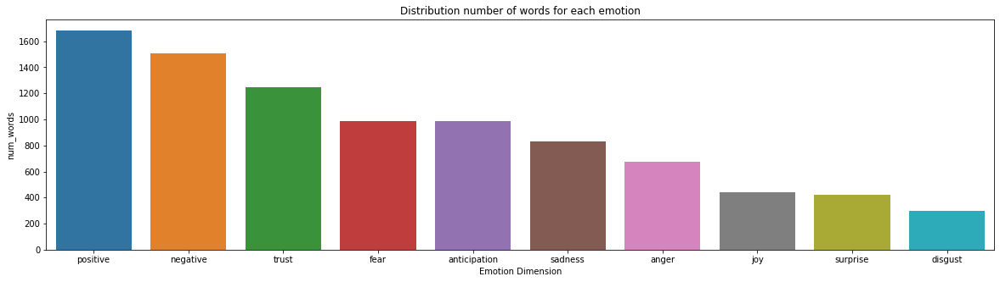

In [ ]:
############### Building histogram of the words in each emotion dimension

fig, ax = plt.subplots(figsize=(20,5))
# plt.xticks(rotation = 90)
plt.xlabel('Emotion Dimension')
plt.ylabel('Number of words')
plt.title('Distribution number of words for each emotion')

ax = sns.barplot(x=emotion_word_count_df.index, y=emotion_word_count_df['num_words'])

In [ ]:
############### Tweets with positive emotion words

print('\n ############### Tweets with positive emotion words = ############### \n')

cnnfailTag_q5a[cnnfailTag_q5a.positive == 2][['cleaned_tweet', 'emotion_words']].head(5)


 ############### Tweets with positive emotion words = ############### 



,cleaned_tweet,emotion_words
2604754,CNN isn't interested in covering Iran. I guess the news director can't shuffle the segments?,"{'interested': ['disgust', 'positive', 'sadness'], 'guess': ['surprise'], 'director': ['positive', 'trust']}"
2605273,CNN lead story is flags Maybe if Iran had bankrupt amusement CNN would mention.,"{'lead': ['positive'], 'bankrupt': ['fear', 'negative', 'sadness'], 'amusement': ['joy', 'positive']}"
2605325,"TB video de la BBC, reporter protg de la police par les iraniens, see that BBC video as","{'reporter': ['positive', 'trust'], 'police': ['fear', 'positive', 'trust']}"
2615828,"Video de la BBC, reporter protg de la police par les iraniens ( )","{'reporter': ['positive', 'trust'], 'police': ['fear', 'positive', 'trust']}"
2618921,we should all urge to tweet about & to prove the real power of social media!,"{'prove': ['positive'], 'real': ['positive', 'trust']}"


### **Answer 5.a**

1. The **Positive emotion** is the **most frequent** emotion for the tweets related to #cnnfail.

2. The **Positive emotion doesnot match** with the theme of cnn not covering the riots and protests of iran election. The reasons are evident in the tweets displayed above for positive emotions.; 

"CNN isn't interested in covering Iran. I guess the news director can't shuffle the segments?	" = **Wrong Context for stating the words as positive**

"CNN lead story is flags Maybe if Iran had bankrupt amusement CNN would mention." = **Unable to identify sarcasm for emotion context**
      
    a. The tweet have words such as "attention", "interested", "reporter" and "police" which are used in a negative context and sometimes in a sarcastic sense. 

    b. The NRCLex is not identifying the emotion related to the word with the context.

    c. Hence the positive emotions has the highest frequency of words, but it doesnot mean that the theme of the tweets are positive.

### **5 (b) For each user, determine which fraction of a user's total identifed words are in each emotional affect (i.e., normalize the counts for each user). Identify the users with the highest fraction of words in each emotion. Note: You may wish to set a minimum number of tweets for user's to be considered.**


 ############### Number of Users with more than equal to 10 tweets ############### 

(56,)


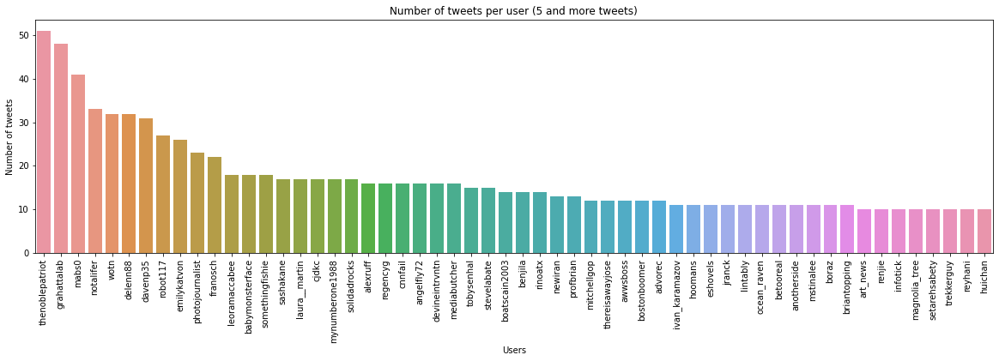

In [ ]:
############### Building histogram of number of tweets per user
min_tweet_count = 10

fig, ax = plt.subplots(figsize=(20,5))
plt.xticks(rotation = 90)
plt.xlabel('Users')
plt.ylabel('Number of tweets')
plt.title('Number of tweets per user (5 and more tweets)')

print('\n ############### Number of Users with more than equal to', min_tweet_count, 'tweets ############### \n')
user_select_series = cnnfailTag_q5a.user.value_counts()
user_select_series = user_select_series[user_select_series>=min_tweet_count]

print(user_select_series.shape)

ax = sns.barplot(x=user_select_series.index, y=user_select_series.values)

In [ ]:
############### Filtering dataframe with selected users

cnnfailTag_q5b = cnnfailTag_q5a[cnnfailTag_q5a.user.isin(user_select_series.index.values)]

In [ ]:
############### Getting users fraction of emotions

cnnfailTag_q5b_grouped = cnnfailTag_q5b.groupby(['user'])[['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 'negative', 'sadness', 'disgust', 'joy']].sum()
cnnfailTag_q5b_grouped['sum'] = cnnfailTag_q5b_grouped.sum(axis=1)
cnnfailTag_q5b_grouped.loc[:,"fear":"joy"] = cnnfailTag_q5b_grouped.loc[:,"fear":"joy"].div(cnnfailTag_q5b_grouped["sum"], axis=0)
cnnfailTag_q5b_grouped.head(3)

,fear,anger,anticipation,trust,surprise,positive,negative,sadness,disgust,joy,sum
user,,,,,,,,,,,
advorec,0.148148,0.111111,0.074074,0.111111,0.000000,0.111111,0.296296,0.111111,0.037037,0.000000,27
alexruff,0.500000,0.000000,0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2
angelfly72,0.153846,0.076923,0.115385,0.230769,0.038462,0.230769,0.038462,0.000000,0.000000,0.115385,26


In [ ]:
############### Dropping users which have a total of less than 10 emotion identified words in the column "SUM", 
############### because they serve as outliers to our analyis and may give misleading output.

min_sum_of_total_emot_words = 10

cnnfailTag_q5b_grouped = cnnfailTag_q5b_grouped[cnnfailTag_q5b_grouped['sum'] >= min_sum_of_total_emot_words]
cnnfailTag_q5b_grouped.head(3)

,fear,anger,anticipation,trust,surprise,positive,negative,sadness,disgust,joy,sum
user,,,,,,,,,,,
advorec,0.148148,0.111111,0.074074,0.111111,0.000000,0.111111,0.296296,0.111111,0.037037,0.000000,27
angelfly72,0.153846,0.076923,0.115385,0.230769,0.038462,0.230769,0.038462,0.000000,0.000000,0.115385,26
anotherside,0.076923,0.076923,0.076923,0.153846,0.000000,0.153846,0.153846,0.153846,0.153846,0.000000,13


In [ ]:
############### Getting top 3 users with max rating for each emotion

print('\n ############### top 3 users with maximum fraction of words for each emotion ############### \n')

output_df_q5b = pd.DataFrame(columns=['first', 'second', 'third'])
for i in cnnfailTag_q5b_grouped.loc[:, 'fear':'joy'].columns:
  output_df_q5b.loc[i] = list(cnnfailTag_q5b_grouped[i].nlargest(3).index)

output_df_q5b


 ############### top 3 users with maximum fraction of words for each emotion ############### 



,first,second,third
fear,huichan,mstinalee,setarehsabety
anger,lintably,ocean_raven,trekkerguy
anticipation,huichan,mitchellgop,mediabutcher
trust,stevelabate,ivan_karamazov,newiran
surprise,mitchellgop,laura__martin,newiran
positive,stevelabate,rinoatx,eshovels
negative,advorec,tobysenhal,babymonsterface
sadness,setarehsabety,anotherside,regencyg
disgust,anotherside,solidadrocks,magnolia_tree
joy,somethingfishie,boraz,mitchellgop


### **5 (c) Construct a plot(s) to answer the following: Is there a correlation between any dimension of emotion and one of the centrality measures you evaluated? If you see a trend, please provide a hypothesis for why; if you do not see a trend, provide a hypothesis for why centrality of a user has no observed correlation with emotion in your particular dataset.**

In [ ]:
############### Analysis on the user and mentioned data with the graph nodes obtained

print('\n ############### Analysis on the user and mentioned data with the graph nodes obtained ###############\n')


set_of_users = set(list(cnnfailTag_q5a.user))
set_of_mentioned = set([item for sublist in list(cnnfailTag_q5a.mentioned) for item in sublist])
set_of_nodes = set(cnnfailGraph_spring.nodes())

print('\n ############### number of unique users')
print(len(set_of_users))

print('\n ############### number of unique mentions')
print(len(set_of_mentioned))

print('\n ############### Union of the users and mentions')
user_union_mentioned = set_of_users.union(set_of_mentioned)
print(len(user_union_mentioned))

print('\n ############### Set of nodes')
print(len(set_of_nodes))

print('\n ********** set difference between (user union mentions) and (the graph nodes) length ********** \n')
print(len(user_union_mentioned - set_of_nodes))


 ############### Analysis on the user and mentioned data with the graph nodes obtained ###############


 ############### number of unique users
2271

 ############### number of unique mentions
1537

 ############### Union of the users and mentions
3237

 ############### Set of nodes
2740

 ********** set difference between (user union mentions) and (the graph nodes) length ********** 

497


### **Observation from above analysis**

All the unique users are not in the graph nodes from which centrality is calculated. This is because of the fact that some users have not mentioned anyone in the dataset, hence they had no node to connect to, so no node was created for them

So, we will filter our the dataframe that we have with the emotion using the nodes which exist in the graph (for centality and emotion analysis)

In [ ]:
############### Filtering users using the graph nodes

cnnfailTag_q5c = cnnfailTag_q5a.copy()
cnnfailTag_q5c = cnnfailTag_q5c[cnnfailTag_q5c.user.isin(set_of_nodes)]

############### Getting the betweenness and page rank centrality

cnnfailTag_q5c['betweenness_cent'] = cnnfailTag_q5c['user'].apply(lambda x: between_cent_dict[x])
cnnfailTag_q5c['pagerank_cent'] = cnnfailTag_q5c['user'].apply(lambda x: pagerank_dict[x])

In [ ]:
cnnfailTag_q5c.head(2)

,date,user,tweet,mentioned,cleaned_tweet,fear,anger,anticipation,trust,surprise,positive,negative,sadness,disgust,joy,emotion_words,betweenness_cent,pagerank_cent
2575522,2009-06-14 02:14:43,sxyblkmn,RT @MattReeves17: Help put pressure on CNN to cover the IRAN protests more by putting #CNNfail in your tweets! #IranElection,[mattreeves17],Help put pressure on CNN to cover the IRAN protests more by putting in your tweets!,0,0,0,1,0,0,1,0,0,0,"{'pressure': ['negative'], 'cover': ['trust']}",0.001086,0.000542
2575948,2009-06-14 02:15:29,saharou,RT @MattReeves17: Help put pressure on CNN to cover the IRAN protests more by putting #CNNfail in your tweets! #IranElection,[mattreeves17],Help put pressure on CNN to cover the IRAN protests more by putting in your tweets!,0,0,0,1,0,0,1,0,0,0,"{'pressure': ['negative'], 'cover': ['trust']}",0.000004,0.000324


In [ ]:
############### Correlation plot function

def plot_corr_heatmap(cnnfailTag_q5c, list_of_col = ['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 
                                                     'negative', 'sadness', 'disgust', 'joy', 'betweenness_cent'], measure = 'betweenness_cent'):
  
  corr = cnnfailTag_q5c.loc[:,list_of_col].corr()
  mask = np.triu(np.ones_like(corr, dtype=bool)) #masking upper triangle

  figure, ax = plt.subplots(figsize=(11, 9))
  cmap = sns.diverging_palette(240, 10, as_cmap=True)
  ax.set_title('Corr Heatmap for '+measure, fontsize = 15)
  ax = sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

  
  return ax

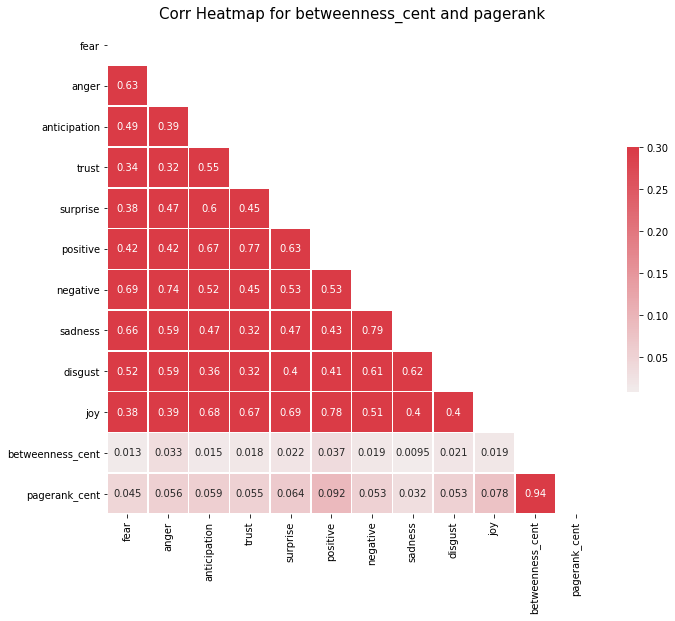

In [ ]:
plot_corr_heatmap(cnnfailTag_q5c, list_of_col = ['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 
                                                     'negative', 'sadness', 'disgust', 'joy', 'betweenness_cent', 'pagerank_cent'], 
                  measure = 'betweenness_cent and pagerank')

In [ ]:
############### Correlation plot using grouped data (sum of emotions and mean of centrality)

cnnfailTag_q5c_grouped = cnnfailTag_q5c.groupby(['user']).agg({'fear': 'sum', 'anger': 'sum', 'anticipation': 'sum', 'trust': 'sum', 'surprise': 'sum', 
                                                               'positive': 'sum', 'negative': 'sum', 'sadness': 'sum', 'disgust': 'sum', 'joy': 'sum', 
                                                               'betweenness_cent': 'mean',
                                                               'pagerank_cent': 'mean'})

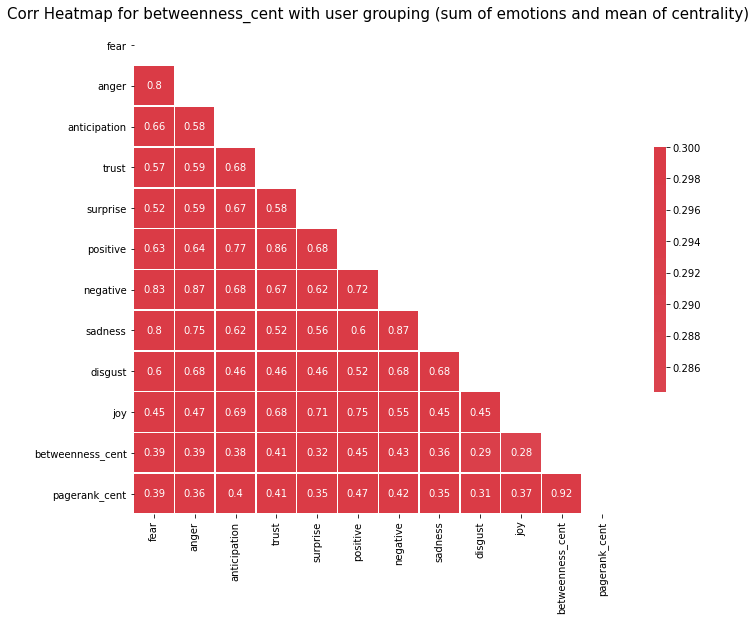

In [ ]:
plot_corr_heatmap(cnnfailTag_q5c_grouped, 
                  list_of_col = ['fear', 'anger', 'anticipation', 'trust', 'surprise', 'positive', 
                                                     'negative', 'sadness', 'disgust', 'joy', 'betweenness_cent', 'pagerank_cent'], 
                  measure = 'betweenness_cent with user grouping (sum of emotions and mean of centrality)')

### **Answer 5.c**

Based on the experiements with correltaion heatmaps above, **there seems to be a good correlation** between emotions and centrality **only** when the sum of all emotions per user is considered with the mean of centrality. (grouped data). The correaltion goes as high as 0.47 between positive emotion and page rank.

This can be due to the fact that a user expressing high degree of emotions tend to be connected to other users as well, hence emotional posts due to their connectivity with others and possible reposts, might become a good centre for the graph both by pagerank and betweenness.

